In [19]:
%load_ext lab_black

ModuleNotFoundError: No module named 'lab_black'

In [1]:
# one hot encode runway
# ordinal encode airline
# TODO: Try with avg pb time, ratioH/M, ratio nominal
from traffic.core import Traffic

import pandas as pd
import numpy as np
import pickle

import os.path

from ipyleaflet import Polygon
from ipywidgets import Layout
from ipyleaflet import Map, Marker

import altair as alt

from cartes.osm import Overpass

from sklearn import svm

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import classification_report, confusion_matrix

from numpy import mean
from numpy import std
from sklearn.compose import ColumnTransformer
from sklearn.datasets import fetch_openml
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV

In [2]:
from ground_analysis.build_features import gather_data

In [3]:
%load_ext lab_black

ModuleNotFoundError: No module named 'lab_black'

In [ ]:
from ground_analysis.utils import within_Xmin
from ground_analysis.extract_flight_info import onehot_runways, assign_twy_occ

In [89]:
from pickle import load, dump

In [102]:
import pandas as pd
import numpy as np

from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import altair as alt

from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt

from collections import namedtuple

import os


ResMetrics = namedtuple(  # create a personalized tuple
    "ResMetrics", "mae mse rmse acc1min acc3min acc5min r2"
)


def within_Xmin(real, pred, m=1):
    assert len(real) == len(pred)
    c = 0
    for r, p in zip(real, pred):
        if abs(r - p) < m:
            c += 1
    return c / len(real) * 100


def plot_results(labels_test, predicted):
    # plot pred vs truth
    data_chart = pd.DataFrame(
        {"true": labels_test.values.reshape((-1,)), "pred": predicted}
    )
    predVStrue_chart = alt.Chart(data_chart).mark_circle(opacity=0.5).encode(
        x="true", y="pred"
    ) + alt.Chart(
        pd.DataFrame({"x": np.linspace(0, 25, 10), "y": np.linspace(0, 25, 10)})
    ).mark_line(
        color="black"
    ).encode(
        x="x", y="y"
    )
    return predVStrue_chart

def feature_importance_chart(feature_columns, clf):
    col = feature_columns
    # modelname.feature_importance_
    y = clf.feature_importances_
    datachart = pd.DataFrame({'feature':col, 'importance':y}).sort_values('importance')
    chart = alt.Chart(datachart).mark_bar().encode(alt.Y('feature', sort="-x"), alt.X("importance")).transform_window(
        rank='rank(importance)',
        sort=[alt.SortField('importance', order='descending')]
    ).transform_filter(
        (alt.datum.rank < 20)
    ).configure_axis(
        labelFont="Ubuntu",
        titleFont="Fira Sans",
        labelFontSize=15,
        titleFontSize=16,
    ).configure_legend(
        orient="bottom", labelFontSize=14, titleFontSize=14, labelFont="Ubuntu"
    ).configure_view(stroke=None).configure_title(font="Fira Sans", fontSize=18, anchor="start", dy=-10).configure_header(
        labelFont="Ubuntu",
        labelFontSize=18,
        labelOrient="top",
    ).properties(width=200)
    return chart

def plot_feature_importance(
    feature_columns,
    clf,  # saveas="../prediction_results/result.png"
):
    col = feature_columns
    # modelname.feature_importance_
    y = clf.feature_importances_
    # plot
    fig, ax = plt.subplots()
    width = 0.2  # the width of the bars
    ind = np.arange(len(y))  # the x locations for the groups
    ax.barh(ind, y, width, color="green")
    ax.set_yticks(ind + width / 10)
    ax.set_yticklabels(col, minor=False)
    plt.title("Feature importance in RandomForest Classifier")
    plt.xlabel("Relative importance")
    plt.ylabel("feature")
    plt.figure(figsize=(5, 8))
    fig.set_size_inches(6.5, 9.5, forward=True)
    return fig


def results(labels_test, predicted):
    mae = mean_absolute_error(labels_test.values.reshape((-1,)), predicted)
    mse = mean_squared_error(labels_test.values.reshape((-1,)), predicted)
    rmse = mse ** (1 / 2)
    acc1min = within_Xmin(labels_test.values.reshape((-1,)), predicted)
    acc3min = within_Xmin(labels_test.values.reshape((-1,)), predicted, m=3)
    acc5min = within_Xmin(labels_test.values.reshape((-1,)), predicted, m=5)
    r2 = r2_score(labels_test.values.reshape((-1,)), predicted)

    return ResMetrics(
        mae=mae,
        mse=mse,
        rmse=rmse,
        acc1min=acc1min,
        acc3min=acc3min,
        acc5min=acc5min,
        r2=r2,
    )


def train_rf(
    flight_df,
    feature_columns,
    target_column,
    query,
    dirname="../prediction_results/rf/",
    dropna=True,
):
    """
    function that will train and plot performance metric
    """
    test_name = dirname.split("/")[-2]

    flight_df = flight_df.query(query)

    data_df = flight_df[feature_columns + [target_column, "first_movement_start"]]

    if dropna:
        data_df = data_df.dropna()
    else:
        data_df = (
            data_df.sort_values("first_movement_start")
            .fillna(method="backfill")
            .dropna()
        )

    data_df = data_df.drop(["first_movement_start"], axis=1)

    input_df = data_df[feature_columns]
    target_df = data_df[[target_column]]

    data_train, data_test, labels_train, labels_test = train_test_split(
        input_df,
        target_df,
        test_size=0.20,
        random_state=42
    )

    clf = RandomForestRegressor(n_estimators=150, min_samples_split=10, max_features="sqrt", random_state=42)

    # fit the model on the whole dataset
    clf.fit(data_train, labels_train)
    # make a single prediction
    predicted = clf.predict(data_test)

    res_metrics = results(labels_test, predicted)

    res_txt = "Results for Random Forest on the following features :\n"
    res_txt += " ".join(feature_columns) + "\n"
    res_txt += f"Target var : {target_column}\n"
    res_txt += "Selecting the subset with following query : \n" + query + "\n"
    res_txt += f"mae={res_metrics.mae}\nmse={res_metrics.mse}\nrmse={res_metrics.rmse}\nacc1min={res_metrics.acc1min}\nacc3min={res_metrics.acc3min}\nacc5min={res_metrics.acc5min}\nAnd R2 = {res_metrics.r2}\n"
    res_txt += f"n_sample training : {data_train.shape[0]}\nn_sample test : {data_test.shape[0]}\nn_sample_tot={input_df.shape[0]}\n"

    print(res_txt)

    corr_chart = plot_results(labels_test, predicted)
    feature_chart = plot_feature_importance(feature_columns, clf)
    top10features_chart = feature_importance_chart(feature_columns, clf)

    os.makedirs(os.path.dirname(dirname), exist_ok=True)
    with open(dirname + "res.txt", "w") as text_file:
        text_file.write(res_txt)
    with open(dirname + f"{test_name}.pkl", "wb") as pklfile:
        dump(res_metrics, pklfile)

    feature_chart.savefig(dirname + "features.png")
    corr_chart.save(dirname + "corr_chart.html")
    top10features_chart.save(dirname + "top10features.html")
    display(top10features_chart)

    return res_metrics, labels_test, predicted, clf

In [13]:
dep_arr_df = pd.read_pickle("../data/processed/dep_arr_df12_onehotconfig_addedsifis.pkl")

In [14]:
dep_arr_df[["flight_id", "max_turnaround_minutes_last30T", "avg_speed_last30T"]].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 35530 entries, 0 to 36009
Data columns (total 3 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   flight_id                       35530 non-null  object 
 1   max_turnaround_minutes_last30T  6149 non-null   float64
 2   avg_speed_last30T               14038 non-null  float64
dtypes: float64(2), object(1)
memory usage: 1.1+ MB


In [62]:
" ".join(dep_arr_df.columns)

'flight_id on_runway_time taxi_holding_time rwy_holding_time total_holding_time taxi_holding_time_minutes first_movement callsign registration typecode icao24 firstseen_min start stop duration cumdist_max parking_position parking_position_duration pb_duration end_pb duration_minutes parking_position_duration_minutes pb_duration_minutes first_movement_start taxi_dist total_holding_time_minutes real_dur real_dur_minutes airline hh hh_num angle_sum avg_speed mvt_type taxiing_stop avg_delay_30min avg_delay_30min_all_trajs avg_delay_in30min avg_delay_in60min avg_delay_in90min avg_delay_in30min_cat avg_delay_in60min_cat avg_delay_in90min_cat turnaround turnaround_minutes max_turnaround_minutes_last30T sifi_DEP sifi_ARR avg_speed_last30T nominal busy disrupted not_nom_arrival_ratio press temp atmap_visibility atmap_wind atmap_precipitation atmap_freezing atmap_danger atmap_score nb_arr nb_dep nb icao_wtc H L L/M M H_count L_count L/M_count M_count H_count_ratio L_count_ratio L/M_count_ratio M

## rename one hot cols

rwy__EAST rwy__NORTH0 rwy__NORTH1 rwy__SOUTH  on

In [22]:
twy_cols = [
    "H_occ",
    "K_occ",
    "B_occ",
    "F_occ",
    "L_occ",
    "J_occ",
    "E_occ",
    "D_occ",
    "C_occ",
    "N_occ",
    "A_occ",
    "M_occ",
    "Y_occ",
    "R_occ",
    "G_occ",
    "Z_occ",
    "P_occ",
]
twy_pca_cols = [
    "twy_pca_0",
    "twy_pca_1",
    "twy_pca_2",
]
apt_congest_cols = ["nb_arr", "nb_dep", "nb", "hh_num"]
sifi_cols = ["aqli_DEP", "scfi_DEP", "aqli_ARR", "scfi_ARR"]
pushback_cols = ["sifi_DEP", "sifi_ARR"]
rwy_cols = ["rwy__10", "rwy__14", "rwy__16", "rwy__28", "rwy__32", "rwy__34"]
taxi_path_cols = ["taxi_dist", "angle_sum"]  # To add if relevant
turnaround_cols = ["turnaround_minutes"]
config_cols = ['rwy__EAST', 'rwy__NORTH0',  'rwy__SOUTH']

asma_cols = [
    "nominal",
    "busy",
    "disrupted",
    "not_nom_arrival_ratio",
]
atmap_cols = [
    "atmap_visibility",
    "atmap_wind",
    "atmap_precipitation",
    "atmap_freezing",
    "atmap_danger",
]
metar_cols = [
    "press",
    "temp",
]
weather_cols = metar_cols + atmap_cols
wtc_counts_cols = [
    "H_count",
    "L_count",
    "L/M_count",
    "M_count",
]
wtc_ratios_cols = [
    "H_count_ratio",
    "L_count_ratio",
    "L/M_count_ratio",
    "M_count_ratio",
]
flight_delay_cols = [
    "real_dur_minutes",
    "total_holding_time_minutes",
    "avg_delay_30min",
]
wtc_one_hot_col = ["H", "L", "L/M", "M"]
mean_sifis_cols = [
    "mean_NDepDep_last30T",
    "mean_aqli_DEP_last30T",
    "mean_scfi_DEP_last30T",
    "mean_aqli_ARR_last30T",
    "mean_scfi_ARR_last30T",
]

In [23]:
withoutflight_related_cols = (
    twy_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
)

In [24]:
withoutFlightRel_norsifis_noronehot_cols = (
    twy_cols
    + apt_congest_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
)

In [25]:
withoutFlightRel_norsifis_noronehot_nortwy_cols = (
    apt_congest_cols + asma_cols + weather_cols + wtc_counts_cols + wtc_ratios_cols + config_cols
)

In [30]:
all_no_na_cols_0 = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
     + pushback_cols
    # + flight_delay_cols
)

withoutFlightRel_norsifis_nortaxipath_1 = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    # + sifi_cols
    + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
     + pushback_cols
    # + flight_delay_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_2 = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
     + pushback_cols
    # + flight_delay_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_nortwysbutpca_3 = (
    # twy_cols
    # + turnaround_cols
    apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
     + pushback_cols
    # + flight_delay_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_nortwysbutpca_noratmap_norasma_norwtcounts_4 = (
    # twy_cols
    # + turnaround_cols
    apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + metar_cols  # weather_cols
    # + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
    # + pushback_cols
    # + flight_delay_cols
    
)


all_cols_a = (
    twy_cols
    + turnaround_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + pushback_cols
    + config_cols
    # + flight_delay_cols
)

all_cols_b = (
    twy_cols
    + turnaround_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + pushback_cols
    + config_cols
    # + flight_delay_cols
    # ADDED
    + mean_sifis_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_2b = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
    # + pushback_cols
    # + flight_delay_cols
    #  ADDED
    + mean_sifis_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_2c = (
    withoutFlightRel_norsifis_nortaxipath_noronehot_2b
    + ["max_turnaround_minutes_last30T", "avg_speed_last30T"]
)

withoutFlightRel_norsifis_nortaxipath_noronehot_nortwysbutpca_3b = (
    # twy_cols
    # + turnaround_cols
    apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
    # + pushback_cols
    # + flight_delay_cols
    #  ADDED
    + mean_sifis_cols
)

withoutFlightRel_norsifis_nortaxipath_noronehot_nortwysbutpca_noratmap_norasma_norwtcounts_4b = (
    # twy_cols
    # + turnaround_cols
    apt_congest_cols
    # + sifi_cols
    # + rwy_cols
    # + taxi_path_cols
    # + asma_cols
    + metar_cols  # weather_cols
    # + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + config_cols
    # + wtc_one_hot_col
    # + pushback_cols
    # + flight_delay_cols
    # ADDED
    + mean_sifis_cols
)
withoutFlightRel_norsifis_nortaxipath_noronehot_4c = (
    withoutFlightRel_norsifis_nortaxipath_noronehot_nortwysbutpca_noratmap_norasma_norwtcounts_4b
    + ["max_turnaround_minutes_last30T", "avg_speed_last30T"]
)

In [41]:
dep_arr_df["DEP"] = np.where(dep_arr_df["mvt_type"]=='DEP',1,0)


,mvt_type,DEP,ARR
0,DEP,1,0
1,DEP,1,0
2,ARR,0,1
3,ARR,0,1
4,ARR,0,1
...,...,...,...
36005,DEP,1,0
36006,DEP,1,0
36007,ARR,0,1
36008,DEP,1,0


In [84]:
# to compare with wang's result
like_wangs_cols = (
    ['DEP', 'temp', "sifi_DEP"]
    + taxi_path_cols 
)

withoutFlightRel_norsifis_nortaxipath_1 = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    # + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
     + pushback_cols
    +['DEP']
    # + flight_delay_cols
)
withoutFlightRel_norsifis_nortaxipath_2 = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    # + sifi_cols
    + rwy_cols#  taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
     + pushback_cols
    +['DEP']
    # + flight_delay_cols
)
all_no_na_cols_0bis = (
    twy_cols
    # + turnaround_cols
    + apt_congest_cols
    + sifi_cols
    + rwy_cols
    + taxi_path_cols
    + asma_cols
    + weather_cols
    + wtc_counts_cols
    + wtc_ratios_cols
    + twy_pca_cols
    + wtc_one_hot_col
    + config_cols
     + pushback_cols
    +['DEP']
    # + flight_delay_cols
)

In [ ]:
Feature groups :
    - Taxi path 
        - Taxi geometry
        - Taxi congestion
    - 

Results for Random Forest on the following features :
H_occ K_occ B_occ F_occ L_occ J_occ E_occ D_occ C_occ N_occ A_occ M_occ Y_occ R_occ G_occ Z_occ P_occ nb_arr nb_dep nb hh_num aqli_DEP scfi_DEP aqli_ARR scfi_ARR rwy__10 rwy__14 rwy__16 rwy__28 rwy__32 rwy__34 taxi_dist angle_sum nominal busy disrupted not_nom_arrival_ratio press temp atmap_visibility atmap_wind atmap_precipitation atmap_freezing atmap_danger H_count L_count L/M_count M_count H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio twy_pca_0 twy_pca_1 twy_pca_2 H L L/M M rwy__EAST rwy__NORTH0 rwy__SOUTH sifi_DEP sifi_ARR DEP
Target var : real_dur_minutes
Selecting the subset with following query : 
parking_position==parking_position
mae=1.3185453219790368
mse=6.461898822907078
rmse=2.542026518922861
acc1min=52.069716775599126
acc3min=92.33115468409586
acc5min=98.38779956427015
And R2 = 0.7614585829399548
n_sample training : 9176
n_sample test : 2295
n_sample_tot=11471



alt.Chart(...)

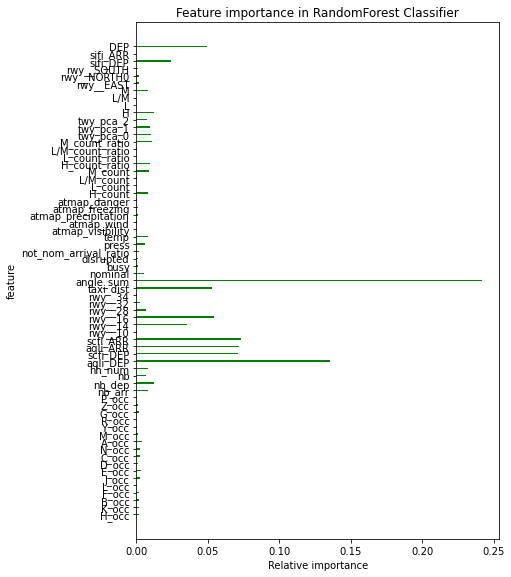

<Figure size 360x576 with 0 Axes>

In [105]:
test_name = "temp/"
# avg_delay_in30min   real_dur_minutes
res, labels_test, predicted, clf = train_rf(
    dep_arr_df,
    all_no_na_cols_0bis ,
    "taxi_holding_time_minutes",
    query="parking_position==parking_position",
    dirname=base_dir + test_name,
    dropna=False,
)

In [54]:
plot_results(labels_test, predicted)

alt.LayerChart(...)

#### on why using fillna(bfill)

In [335]:
datachart = (
    dep_arr_df.query(
        "first_movement_start.dt.day==5 & first_movement_start.dt.month==10"
    )[["first_movement_start", "mean_NDepDep_last30T"]]
    .sort_values("first_movement_start")
    .fillna(method="backfill")
)
nona_chart = (
    alt.Chart(datachart)
    .mark_line()
    .encode(x="first_movement_start:T", y="mean_NDepDep_last30T")
)
na_chart = (
    alt.Chart(
        dep_arr_df.query(
            "first_movement_start.dt.day==5 & first_movement_start.dt.month==10"
        )[["first_movement_start", "mean_NDepDep_last30T"]]
    )
    .mark_line()
    .encode(
        x="first_movement_start:T",
        y="mean_NDepDep_last30T",
        tooltip="utchoursminutes(first_movement_start)",
    )
)
nona_chart & na_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.VConcatChart(...)

### on why query is important over our metrics when dropna = false

In [252]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

In [266]:
dep_arr_df_completed = (
    dep_arr_df.drop("rwy_holding_time", axis=1)
    .sort_values("first_movement_start")
    .fillna(method="backfill")
)
dep_arr_df_completed.shape, dep_arr_df.shape

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


((36010, 111), (36010, 112))

In [277]:
datachart = (
    dep_arr_df.drop("rwy_holding_time", axis=1)
    .sort_values("first_movement_start")
    .query('mvt_type=="DEP"')
    .fillna(method="backfill")[["avg_delay_in30min"]]
)

print(datachart["avg_delay_in30min"].describe())
noquery_chart = (
    alt.Chart(datachart)
    .transform_density("avg_delay_in30min", extent=(0, 20))
    .mark_line()
    .encode(x="value:Q", y="density:Q")
)

datachart = dep_arr_df.query("parking_position==parking_position & mvt_type=='DEP'")[
    ["avg_delay_in30min"]
].dropna()
print(datachart["avg_delay_in30min"].describe())
fulldep_chart = (
    alt.Chart(datachart)
    .transform_density("avg_delay_in30min", extent=(0, 20))
    .mark_line(color="red")
    .encode(x="value:Q", y="density:Q")
)

noquery_chart + fulldep_chart

count    16932.000000
mean         4.623232
std          2.291149
min          0.000000
25%          3.077778
50%          4.409722
75%          5.787179
max         45.316667
Name: avg_delay_in30min, dtype: float64
count    7.415000e+03
mean     4.893343e+00
std      2.375852e+00
min      3.552714e-15
25%      3.303333e+00
50%      4.631481e+00
75%      6.015909e+00
max      4.531667e+01
Name: avg_delay_in30min, dtype: float64


alt.LayerChart(...)

### on what happens if avg_delay is computed only with delays from full trajectories

In [301]:
full_dep_df = dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position')
real_avg_delay_df = (
    full_dep_df.sort_values("first_movement_start")
    .reset_index()
    .set_index("first_movement_start")
    .rolling("30T")
    .agg({"total_holding_time_minutes": "mean", "flight_id": "count"})
    .rename(
        columns={
            "total_holding_time_minutes": "real_avg_delay",
            "flight_id": "n_full_flights",
        }
    )
    .reset_index()
)

full_dep_real_avg_delay_df = pd.merge_asof(
    full_dep_df, real_avg_delay_df, on="first_movement_start"
)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [305]:
real_avg_delay_df["first_movement_start_minus30min"] = real_avg_delay_df[
    "first_movement_start"
] - pd.Timedelta("30T")

res_df = pd.merge_asof(
    full_dep_real_avg_delay_df,
    real_avg_delay_df[["first_movement_start_minus30min", "real_avg_delay"]].rename(
        columns={"real_avg_delay": "next_real_avg_delay"}
    ),
    left_on="first_movement_start",
    right_on="first_movement_start_minus30min",
)

In [361]:
datachart = res_df[["real_avg_delay"]].dropna()
avg_delay_full_taxiing_chart = (
    alt.Chart(datachart)
    .transform_density("real_avg_delay")
    .mark_line(color="green")
    .encode(x="value:Q", y="density:Q")
)
avg_delay_full_taxiing_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.Chart(...)

Results for Random Forest on the following features :
nb_arr nb_dep nb hh_num press temp H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio twy_pca_0 twy_pca_1 twy_pca_2 mean_NDepDep_last30T mean_aqli_DEP_last30T mean_scfi_DEP_last30T mean_aqli_ARR_last30T mean_scfi_ARR_last30T max_turnaround_minutes_last30T avg_speed_last30T
Target var : next_real_avg_delay
Selecting the subset with following query : 
flight_id==flight_id
mae=1.2753885244351109
mse=3.3385084814115022
rmse=1.827158581352889
acc1min=54.0948275862069
acc3min=92.13362068965517
acc5min=98.27586206896551
And R2 = 0.44583299861876957
n_sample training : 3710
n_sample test : 928
n_sample_tot=4638



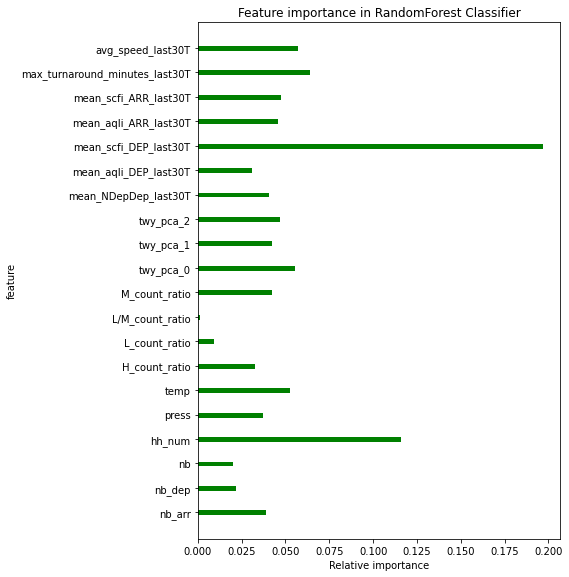

<Figure size 360x576 with 0 Axes>

In [313]:
test_name = (
    "08_realAvgDelay_full_trajs_4c_withoutFlightRel_norsifis_nortaxipath_noronehot/"
)
# avg_delay_in30min   real_dur_minutes
res, labels_test, predicted = train_rf(
    res_df,
    withoutFlightRel_norsifis_nortaxipath_noronehot_4c,
    "next_real_avg_delay",
    query="flight_id==flight_id",
    dirname=base_dir + test_name,
    dropna=True,
)

In [315]:
plot_results(labels_test, predicted)

alt.LayerChart(...)

<AxesSubplot:>

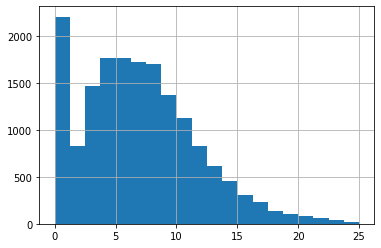

In [321]:
dep_arr_df.query('mvt_type=="DEP"').real_dur_minutes.hist(range=(0, 25), bins=20)

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


<AxesSubplot:>

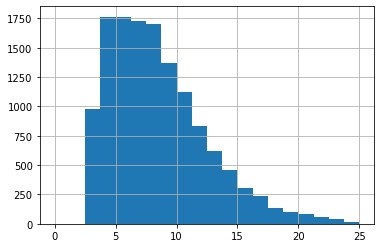

In [336]:
dep_arr_df.query('mvt_type=="DEP" & real_dur_minutes > 3').real_dur_minutes.hist(
    range=(0, 25), bins=20
)

In [337]:
13407 + 3525

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


16932

In [325]:
dep_arr_df.query('mvt_type=="DEP" & real_dur_minutes > 3').shape, dep_arr_df.query(
    'mvt_type=="DEP" & real_dur_minutes <= 3'
).shape

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


((13407, 112), (3525, 112))

In [349]:
dep_arr_df.query('mvt_type=="DEP" & parking_position==parking_position')

,flight_id,on_runway_time,taxi_holding_time,rwy_holding_time,total_holding_time,taxi_holding_time_minutes,first_movement,callsign,registration,typecode,...,mean_scfi_DEP_last30T,mean_aqli_ARR_last30T,mean_scfi_ARR_last30T,rwy__10,rwy__14,rwy__16,rwy__28,rwy__32,rwy__34,total_holding_time_minutes_cat
1,EDW200_5718,2019-10-01 04:10:37+00:00,0 days 00:01:18,None,0 days 00:04:56,1.300000,2019-10-01 04:03:36+00:00,EDW200,HB-IHZ,A320,...,NaN,NaN,NaN,0,0,0,0,1,0,1.0
10,EDW77D_14374,2019-10-01 04:24:56+00:00,0 days 00:00:00,None,0 days 00:00:00,0.000000,2019-10-01 04:21:26+00:00,EDW77D,HB-JLR,A320,...,0.000000,3.000000,3.000000,0,0,0,0,1,0,0.0
12,EDW15T_7910,2019-10-01 04:31:56+00:00,0 days 00:01:03,None,0 days 00:05:26,1.050000,2019-10-01 04:23:56+00:00,EDW15T,HB-IJV,A320,...,0.500000,2.500000,2.500000,0,0,0,0,1,0,1.0
14,EDW214_7815,2019-10-01 04:35:11+00:00,0 days 00:03:12,None,0 days 00:07:35,3.200000,2019-10-01 04:25:56+00:00,EDW214,HB-IJU,A320,...,1.333333,2.000000,2.333333,0,0,0,0,1,0,1.0
18,TAP929_5192,2019-10-01 04:41:09+00:00,0 days 00:02:25,None,0 days 00:02:26,2.416667,2019-10-01 04:33:31+00:00,TAP929,CS-TTF,A319,...,1.750000,2.250000,2.500000,0,0,0,0,1,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
36001,UAE86_20078,2019-11-30 21:40:23+00:00,0 days 00:03:08,None,0 days 00:11:14,3.133333,2019-11-30 21:27:01+00:00,UAE86,A6-EEN,A388,...,NaN,NaN,NaN,0,0,0,0,1,0,2.0
36002,SWR80KF_10610,2019-11-30 21:34:35+00:00,0 days 00:00:00,None,0 days 00:04:41,0.000000,2019-11-30 21:28:16+00:00,SWR80KF,HB-JBF,BCS1,...,3.000000,1.000000,1.000000,0,0,0,0,1,0,1.0
36003,SWR256_9233,2019-11-30 21:40:36+00:00,0 days 00:00:00,None,0 days 00:04:38,0.000000,2019-11-30 21:33:56+00:00,SWR256,HB-ION,A321,...,2.500000,0.500000,0.500000,0,0,0,0,0,1,1.0
36005,SWR176_15653,2019-11-30 22:02:47+00:00,0 days 00:02:16,None,0 days 00:15:41,2.266667,2019-11-30 21:44:51+00:00,SWR176,HB-JNJ,B77W,...,2.333333,0.666667,0.666667,0,1,0,0,0,0,2.0


<AxesSubplot:>

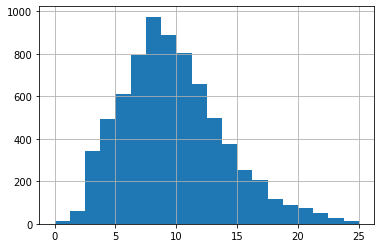

In [320]:
dep_arr_df.query(
    'mvt_type=="DEP" & parking_position==parking_position'
).real_dur_minutes.hist(range=(0, 25), bins=20)

<AxesSubplot:>

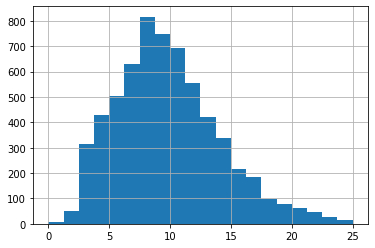

In [322]:
dep_arr_df.query('mvt_type=="DEP" & end_pb==end_pb').real_dur_minutes.hist(
    range=(0, 25), bins=20
)

In [326]:
def compute_avg_duration(
    dep_df,
    dt="30T",
    time_col="on_runway_time",
    on_col="total_holding_time_minutes",
    col_name="avg_delay",
):
    # Index is on_runway_time because it makes more sense to compute average
    # ground delays with flights having completed their taxi
    avg_delays = (
        dep_df.set_index(time_col)
        .sort_index()[on_col]
        .rolling(dt)  # closed="left" not needed as it is the target variable
        .agg("mean")
        .rename(col_name)
    )
    dep_df = pd.merge_asof(
        dep_df.sort_values(time_col),
        avg_delays,
        left_on=time_col,
        right_index=True,
    )
    return dep_df

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [1]:
long_enough_taxiing_df = dep_arr_df.query('mvt_type=="DEP" & real_dur_minutes > 5')
long_enough_taxiing_df = compute_avg_duration(
    long_enough_taxiing_df,
    on_col="taxi_holding_time_minutes",  # "taxi_holding_time_minutes",
    col_name="long_enough_delay",
)
datachart = long_enough_taxiing_df[["first_movement_start", "long_enough_delay"]]
long_enough_taxiin_chart = (
    alt.Chart(datachart)
    .transform_density("long_enough_delay")
    .mark_line(color="orange")
    .encode(x="value:Q", y="density:Q")
)
long_enough_taxiin_chart

NameError: name 'dep_arr_df' is not defined

In [380]:
long_enough_taxiing_taxiholdavg_df = dep_arr_df.query(
    'mvt_type=="DEP" & real_dur_minutes > 3'
)
long_enough_taxiing_taxiholdavg_df = compute_avg_duration(
    long_enough_taxiing_taxiholdavg_df,
    on_col="taxi_holding_time_minutes",  # "taxi_holding_time_minutes",
    col_name="long_enough_delay",
)
datachart = long_enough_taxiing_taxiholdavg_df[
    ["first_movement_start", "long_enough_delay"]
]
long_enough_taxiing_taxiholdavg_chart = (
    alt.Chart(datachart)
    .transform_density("long_enough_delay")
    .mark_line(color="orange", strokeDash=[5, 5])
    .encode(x="value:Q", y="density:Q")
)
long_enough_taxiing_taxiholdavg_chart

alt.Chart(...)

In [381]:
fulltaxi_taxiholdavg_chart + taxiholdavg_chart + long_enough_taxiing_taxiholdavg_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.LayerChart(...)

In [371]:
taxiholdavg_df = dep_arr_df.query('mvt_type=="DEP"')
taxiholdavg_df = compute_avg_duration(
    taxiholdavg_df,
    on_col="taxi_holding_time_minutes",  # "taxi_holding_time_minutes",
    col_name="avg_taxi_delay",
)
datachart = taxiholdavg_df[["first_movement_start", "avg_taxi_delay"]]
taxiholdavg_chart = (
    alt.Chart(datachart)
    .transform_density("avg_taxi_delay")
    .mark_line(strokeDash=[5, 5])
    .encode(x="value:Q", y="density:Q")
)
taxiholdavg_chart

alt.Chart(...)

In [372]:
taxiholdavg_chart + noquery_chart + long_enough_taxiing_taxiholdavg_chart

alt.LayerChart(...)

In [373]:
fulltaxi_taxiholdavg_df = dep_arr_df.query(
    'mvt_type=="DEP" & parking_position==parking_position'
)
fulltaxi_taxiholdavg_df = compute_avg_duration(
    fulltaxi_taxiholdavg_df,
    on_col="taxi_holding_time_minutes",  # "taxi_holding_time_minutes",
    col_name="long_enough_delay",
)
datachart = fulltaxi_taxiholdavg_df[["first_movement_start", "long_enough_delay"]]
fulltaxi_taxiholdavg_chart = (
    alt.Chart(datachart)
    .transform_density("long_enough_delay")
    .mark_line(color="green", strokeDash=[5, 5])
    .encode(x="value:Q", y="density:Q")
)
fulltaxi_taxiholdavg_chart

alt.Chart(...)

In [354]:
noquery_chart + fulldep_chart + avg_delay_full_taxiing_chart + long_enough_taxiin_chart

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


alt.LayerChart(...)

In [384]:
(
    noquery_chart
    + fulldep_chart
    + avg_delay_full_taxiing_chart
    + long_enough_taxiin_chart
    + fulltaxi_taxiholdavg_chart
    + taxiholdavg_chart
    + long_enough_taxiing_taxiholdavg_chart
)

alt.LayerChart(...)

In [348]:
long_enough_taxiing_df.shape

(10636, 113)

# GRADIENT BOOSTING

In [216]:
from sklearn.ensemble import GradientBoostingRegressor

/home/service/miniconda3/envs/py39v7/lib/python3.8/site-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [221]:
def train_gb(
    flight_df,
    feature_columns,
    target_column,
    query,
    dirname="../prediction_results/rf/",
):
    """
    function that will train and plot performance metric
    """
    test_name = dirname.split("/")[-2]

    flight_df = flight_df.query(query)

    data_df = flight_df[feature_columns + [target_column]].dropna()

    input_df = data_df[feature_columns]
    target_df = data_df[[target_column]]

    data_train, data_test, labels_train, labels_test = train_test_split(
        input_df,
        target_df,
        test_size=0.20,
    )

    clf = GradientBoostingRegressor(n_estimators=150, min_samples_split=10)

    # fit the model on the whole dataset
    clf.fit(data_train, labels_train)
    # make a single prediction
    predicted = clf.predict(data_test)

    res_metrics = results(labels_test, predicted)

    res_txt = "Results for Random Forest on the following features :\n"
    res_txt += " ".join(feature_columns) + "\n"
    res_txt += f"Target var : {target_column}\n"
    res_txt += "Selecting the subset with following query : \n" + query + "\n"
    res_txt += f"mae={res_metrics.mae}\nmse={res_metrics.mse}\nrmse={res_metrics.rmse}\nacc1min={res_metrics.acc1min}\nacc3min={res_metrics.acc3min}\nacc5min={res_metrics.acc5min}\nAnd R2 = {res_metrics.r2}\n"
    res_txt += f"n_sample training : {data_train.shape[0]}\nn_sample test : {data_test.shape[0]}\nn_sample_tot={input_df.shape[0]}\n"

    print(res_txt)

    corr_chart = plot_results(labels_test, predicted)
    feature_chart = plot_feature_importance(feature_columns, clf)
    """
        os.makedirs(os.path.dirname(dirname), exist_ok=True)
        with open(dirname + "res.txt", "w") as text_file:
            text_file.write(res_txt)
        with open(dirname + f"{test_name}.pkl", "wb") as pklfile:
            dump(res_metrics, pklfile)

        feature_chart.savefig(dirname + "features.png")
        corr_chart.save(dirname + "corr_chart.html")
    """
    return res_metrics, labels_test, predicted

Results for Random Forest on the following features :
nb_arr nb_dep nb hh_num press temp H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio twy_pca_0 twy_pca_1 twy_pca_2 mean_NDepDep_last30T mean_aqli_DEP_last30T mean_scfi_DEP_last30T mean_aqli_ARR_last30T mean_scfi_ARR_last30T max_turnaround_minutes_last30T avg_speed_last30T
Target var : avg_delay_in30min
Selecting the subset with following query : 
parking_position==parking_position
mae=1.1641404808696054
mse=2.557309587078272
rmse=1.5991590249497614
acc1min=53.98706896551724
acc3min=94.9353448275862
acc5min=99.24568965517241
And R2 = 0.423550800652824
n_sample training : 3708
n_sample test : 928
n_sample_tot=4636



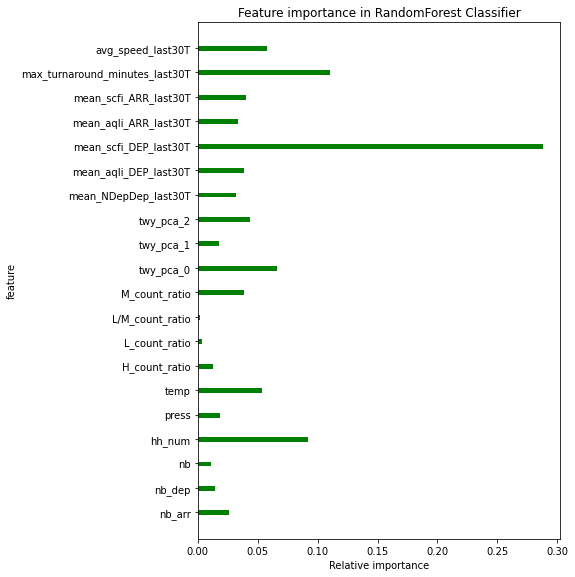

<Figure size 360x576 with 0 Axes>

In [222]:
test_name = "test/"
# avg_delay_in30min   real_dur_minutes
res, labels_test, predicted = train_gb(
    dep_arr_df,
    withoutFlightRel_norsifis_nortaxipath_noronehot_4c,
    "avg_delay_in30min",
    query="parking_position==parking_position",
    dirname=base_dir + test_name,
)

In [ ]:
Target var : avg_delay_in30min
Selecting the subset with following query : 
parking_position==parking_position
mae=1.1381157849329981
mse=2.588340484508701
rmse=1.608832024951238
acc1min=58.02281368821293
acc3min=94.22053231939164
acc5min=98.5551330798479
And R2 = 0.5391126542138664
n_sample training : 5258
n_sample test : 1315
n_sample_tot=6573


# Grandient boosting 2 

In [92]:
from xgboost import XGBRegressor

In [95]:
def train_gb2(
    flight_df,
    feature_columns,
    target_column,
    query,
    dirname="../prediction_results/rf/",
    dropna=False
):
    """
    function that will train and plot performance metric
    """
    test_name = dirname.split("/")[-2]

    flight_df = flight_df.query(query)

    data_df = flight_df[feature_columns + [target_column]].dropna()

    input_df = data_df[feature_columns]
    target_df = data_df[[target_column]]

    data_train, data_test, labels_train, labels_test = train_test_split(
        input_df,
        target_df,
        test_size=0.20,
    )

    clf = XGBRegressor(objective='reg:squarederror')

    # fit the model on the whole dataset
    clf.fit(data_train, labels_train)
    # make a single prediction
    predicted = clf.predict(data_test)

    res_metrics = results(labels_test, predicted)
    
    #scores = cross_val_score(XGBRegressor(objective='reg:squarederror'), X, y, scoring='neg_mean_squared_error')
    #(-scores)**0.5

    res_txt = "Results for Random Forest on the following features :\n"
    res_txt += " ".join(feature_columns) + "\n"
    res_txt += f"Target var : {target_column}\n"
    res_txt += "Selecting the subset with following query : \n" + query + "\n"
    res_txt += f"mae={res_metrics.mae}\nmse={res_metrics.mse}\nrmse={res_metrics.rmse}\nacc1min={res_metrics.acc1min}\nacc3min={res_metrics.acc3min}\nacc5min={res_metrics.acc5min}\nAnd R2 = {res_metrics.r2}\n"
    res_txt += f"n_sample training : {data_train.shape[0]}\nn_sample test : {data_test.shape[0]}\nn_sample_tot={input_df.shape[0]}\n"

    print(res_txt)

    corr_chart = plot_results(labels_test, predicted)
    feature_chart = plot_feature_importance(feature_columns, clf)
    """
        os.makedirs(os.path.dirname(dirname), exist_ok=True)
        with open(dirname + "res.txt", "w") as text_file:
            text_file.write(res_txt)
        with open(dirname + f"{test_name}.pkl", "wb") as pklfile:
            dump(res_metrics, pklfile)

        feature_chart.savefig(dirname + "features.png")
        corr_chart.save(dirname + "corr_chart.html")
    """
    return res_metrics, labels_test, predicted

Results for Random Forest on the following features :
H_occ K_occ B_occ F_occ L_occ J_occ E_occ D_occ C_occ N_occ A_occ M_occ Y_occ R_occ G_occ Z_occ P_occ nb_arr nb_dep nb hh_num aqli_DEP scfi_DEP aqli_ARR scfi_ARR rwy__10 rwy__14 rwy__16 rwy__28 rwy__32 rwy__34 taxi_dist angle_sum nominal busy disrupted not_nom_arrival_ratio press temp atmap_visibility atmap_wind atmap_precipitation atmap_freezing atmap_danger H_count L_count L/M_count M_count H_count_ratio L_count_ratio L/M_count_ratio M_count_ratio twy_pca_0 twy_pca_1 twy_pca_2 H L L/M M rwy__EAST rwy__NORTH0 rwy__SOUTH sifi_DEP sifi_ARR DEP
Target var : real_dur_minutes
Selecting the subset with following query : 
parking_position==parking_position
mae=1.3576199373305977
mse=3.6335922269301677
rmse=1.9061983702988963
acc1min=48.29097283085013
acc3min=91.23575810692375
acc5min=98.24715162138476
And R2 = 0.8601204958137532
n_sample training : 4561
n_sample test : 1141
n_sample_tot=5702



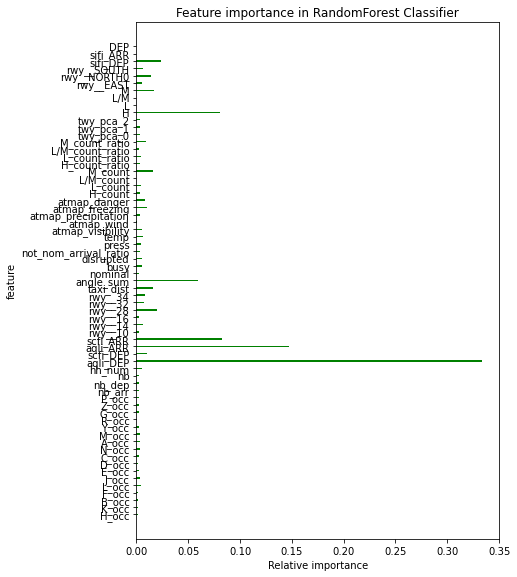

<Figure size 360x576 with 0 Axes>

In [96]:
test_name = "test/04_txot_dep_arr_full_trajsTEMPxgboost"
# avg_delay_in30min   real_dur_minutes
res, labels_test, predicted = train_gb2(
    dep_arr_df,
    all_no_na_cols_0bis,
    "real_dur_minutes",
    query="parking_position==parking_position",
    dirname=base_dir + test_name,
)

In [ ]:
test_name = dirname.split("/")[-2]

flight_df = flight_df.query(query)

data_df = flight_df[feature_columns + [target_column, "first_movement_start"]]

if dropna:
    data_df = data_df.dropna()
else:
    data_df = (
        data_df.sort_values("first_movement_start")
        .fillna(method="backfill")
        .dropna()
    )

data_df = data_df.drop(["first_movement_start"], axis=1)

input_df = data_df[feature_columns]
target_df = data_df[[target_column]]

data_train, data_test, labels_train, labels_test = train_test_split(
    input_df,
    target_df,
    test_size=0.20,
)

clf = RandomForestRegressor(n_estimators=150, min_samples_split=10, max_features="sqrt", random_state=42)

# fit the model on the whole dataset
clf.fit(data_train, labels_train)
# make a single prediction
predicted = clf.predict(data_test)

res_metrics = results(labels_test, predicted)